# Dataset Label Swapping

This notebook swaps the class labels in the `Filtered_Fire_Smoke_Dataset` to match a target schema.

**Transformation:**
- **Old Class 0 (Fire)** -> **New Class 1 (Fire)**
- **Old Class 1 (Smoke)** -> **New Class 0 (Smoke)**

**Input:** `../Filtered_Fire_Smoke_Dataset`
**Output:** `../Filtered_Fire_Smoke_Swapped`

In [1]:
import os
import glob
import shutil
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm

# Configuration
SOURCE_ROOT = r'../Filtered_Fire_Smoke_Dataset'
OUTPUT_ROOT = r'../Filtered_Fire_Smoke_Swapped'

# New Class Mapping for Visualization
NEW_CLASS_NAMES = {0: 'Smoke', 1: 'Fire'}

# Create Output Directories
os.makedirs(os.path.join(OUTPUT_ROOT, 'images'), exist_ok=True)
os.makedirs(os.path.join(OUTPUT_ROOT, 'labels'), exist_ok=True)

print(f"Source: {os.path.abspath(SOURCE_ROOT)}")
print(f"Output: {os.path.abspath(OUTPUT_ROOT)}")

Source: d:\YOLO_WildFire\Filtered_Fire_Smoke_Dataset
Output: d:\YOLO_WildFire\Filtered_Fire_Smoke_Swapped


## 1. Swap Labels and Copy Images

In [2]:
label_files = glob.glob(os.path.join(SOURCE_ROOT, 'labels', '*.txt'))
images_dir = os.path.join(SOURCE_ROOT, 'images')

if not label_files:
    print("WARNING: No label files found. Did you run the previous filtering steps?")

processed_count = 0

for label_path in tqdm(label_files, desc="Swapping Labels"):
    processed_count += 1
    basename = os.path.splitext(os.path.basename(label_path))[0]
    
    # Read original labels
    with open(label_path, 'r') as f:
        lines = f.readlines()
    
    new_lines = []
    for line in lines:
        parts = line.strip().split()
        if len(parts) >= 5:
            cls_id = int(parts[0])
            
            # SWAP LOGIC
            if cls_id == 0:
                new_cls_id = 1
            elif cls_id == 1:
                new_cls_id = 0
            else:
                new_cls_id = cls_id # Keep others if any (shouldn't be)
            
            # Reconstruct line
            new_line = f"{new_cls_id} " + " ".join(parts[1:]) + "\n"
            new_lines.append(new_line)
            
    # Write new label file
    new_label_path = os.path.join(OUTPUT_ROOT, 'labels', basename + '.txt')
    with open(new_label_path, 'w') as f:
        f.writelines(new_lines)
        
    # Copy image
    image_found = False
    for ext in ['.jpg', '.jpeg', '.png']:
        img_path = os.path.join(images_dir, basename + ext)
        if os.path.exists(img_path):
            shutil.copy(img_path, os.path.join(OUTPUT_ROOT, 'images', basename + ext))
            image_found = True
            break
            
    if not image_found:
        print(f"Warning: Image not found for {label_path}")

print(f"\nSwap Complete! Processed {processed_count} files.")

Swapping Labels: 100%|██████████| 2830/2830 [00:52<00:00, 53.76it/s]


Swap Complete! Processed 2830 files.


## 2. Verify Swapped Data
Visualize samples using the **NEW** class mapping (0=Smoke, 1=Fire).
- If correct, Fire objects should have Red boxes (Class 1).
- Smoke objects should have Green boxes (Class 0).

Visualizing random samples from Swapped Dataset:


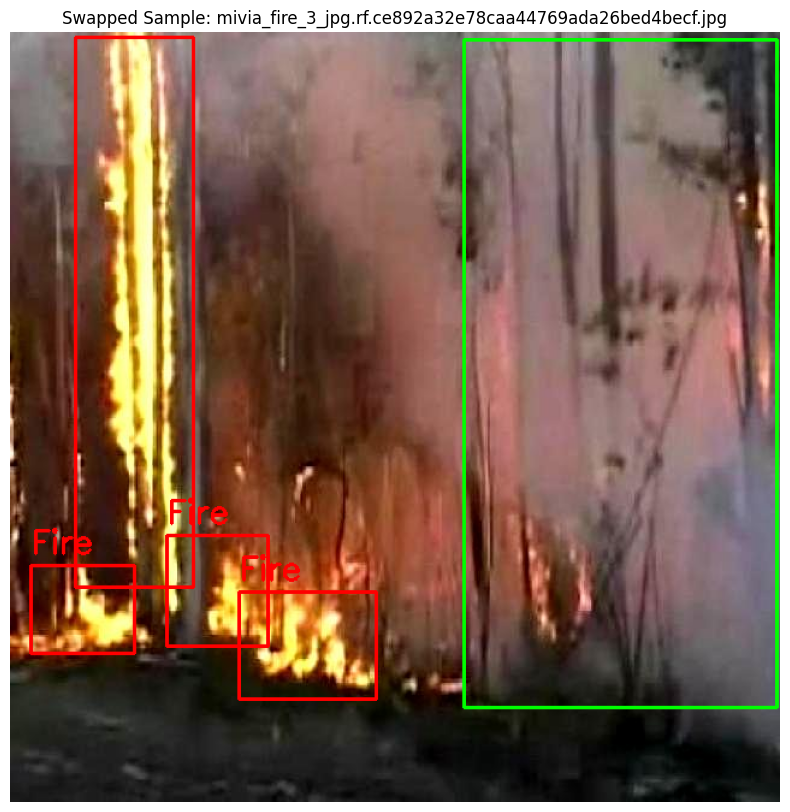

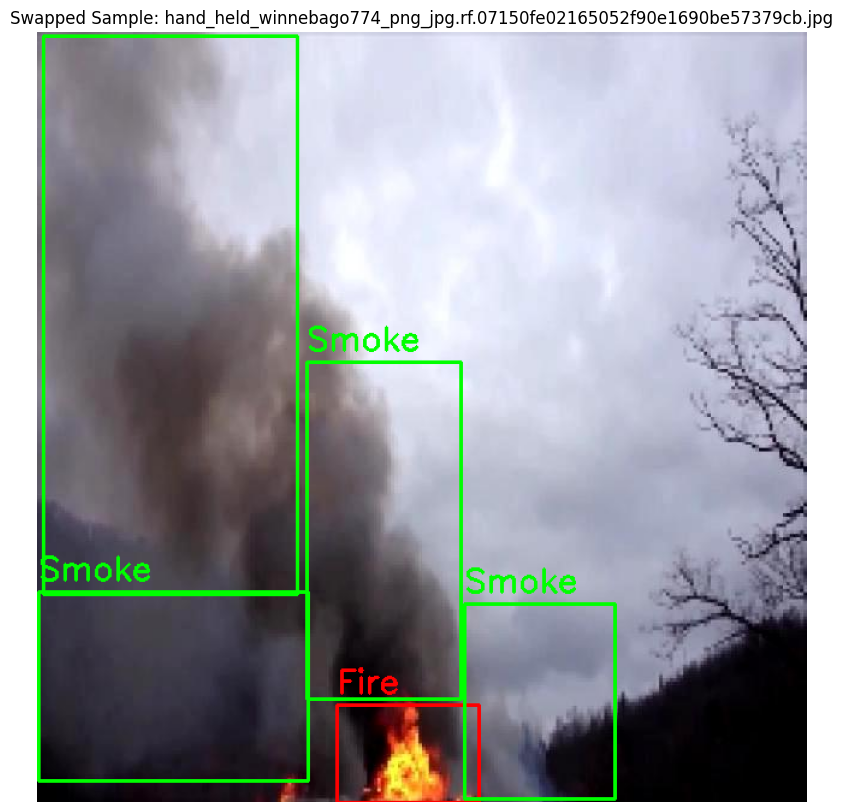

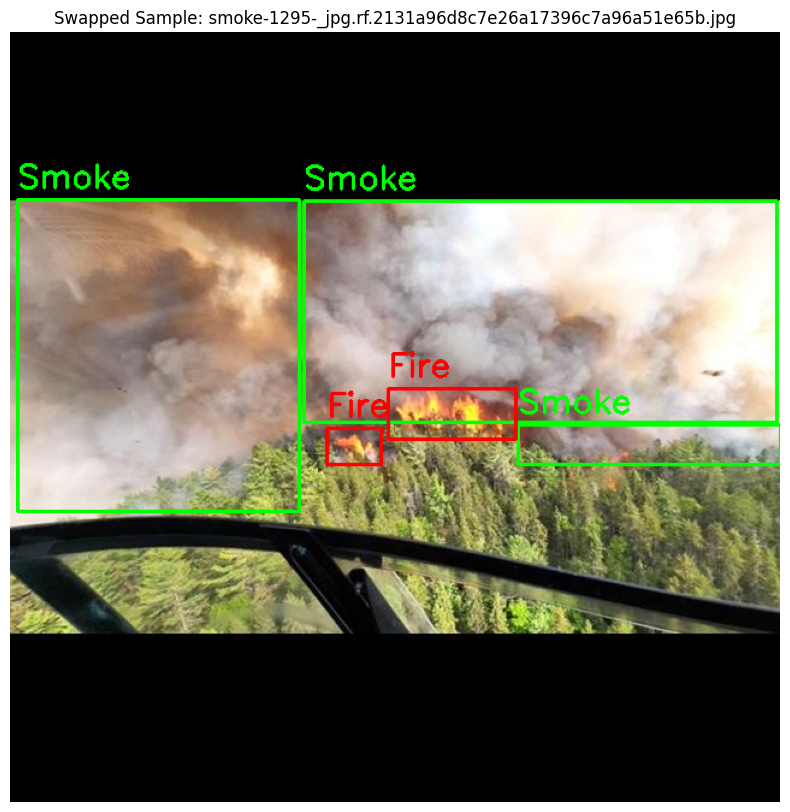

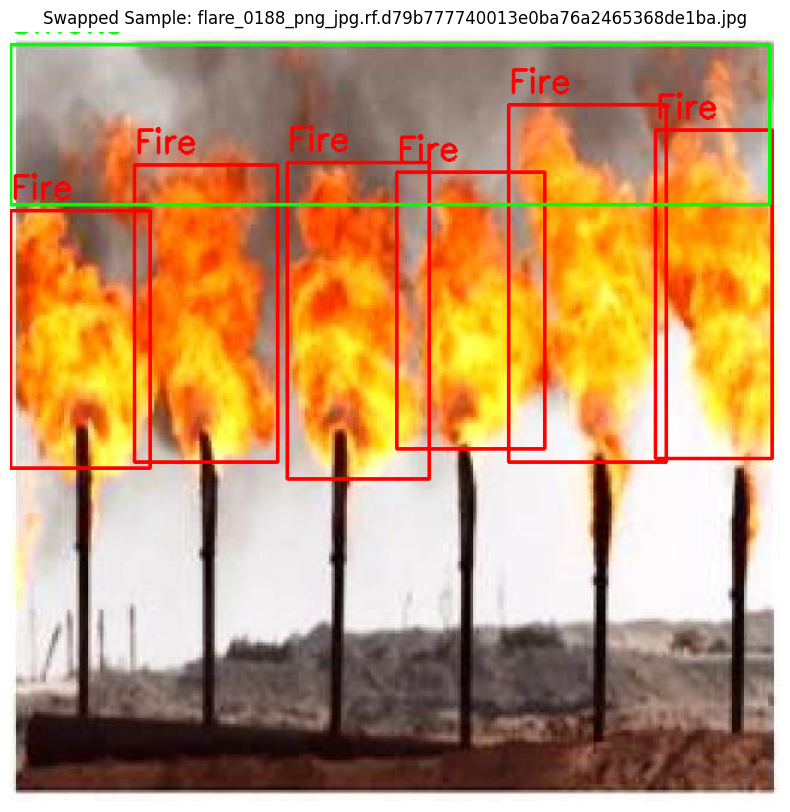

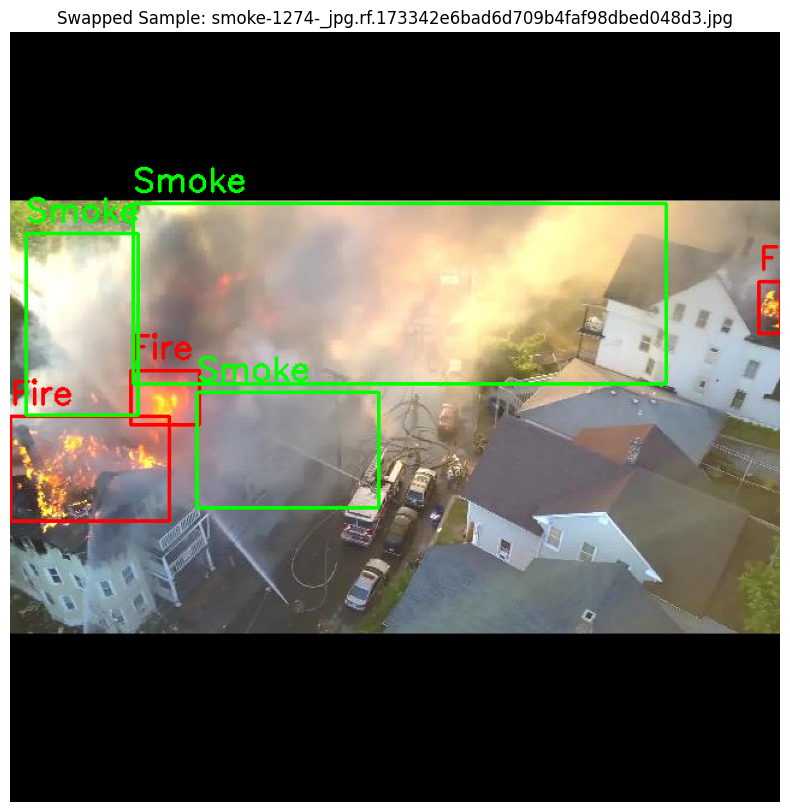

...

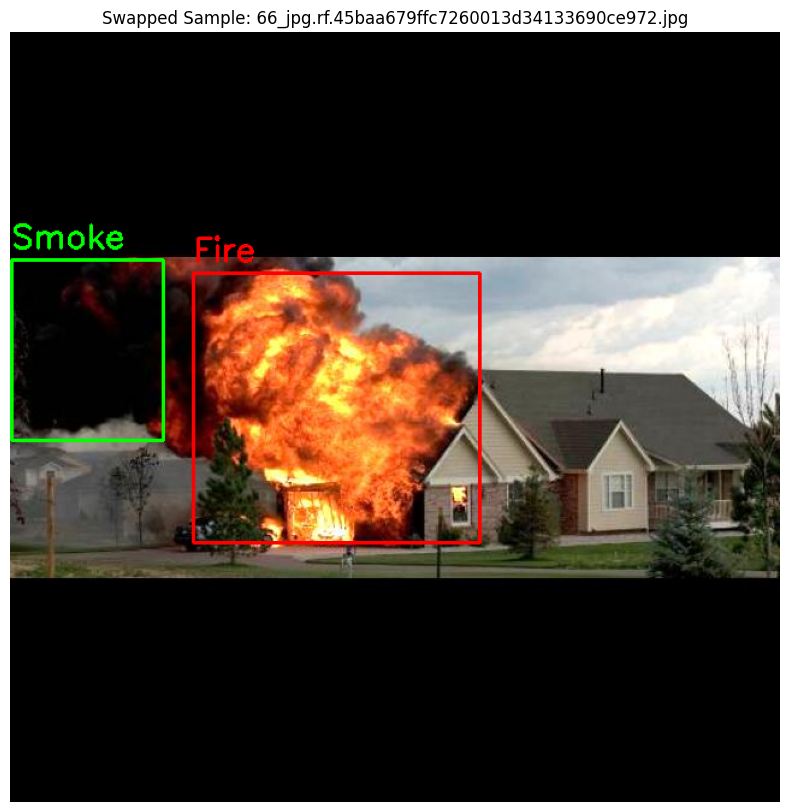

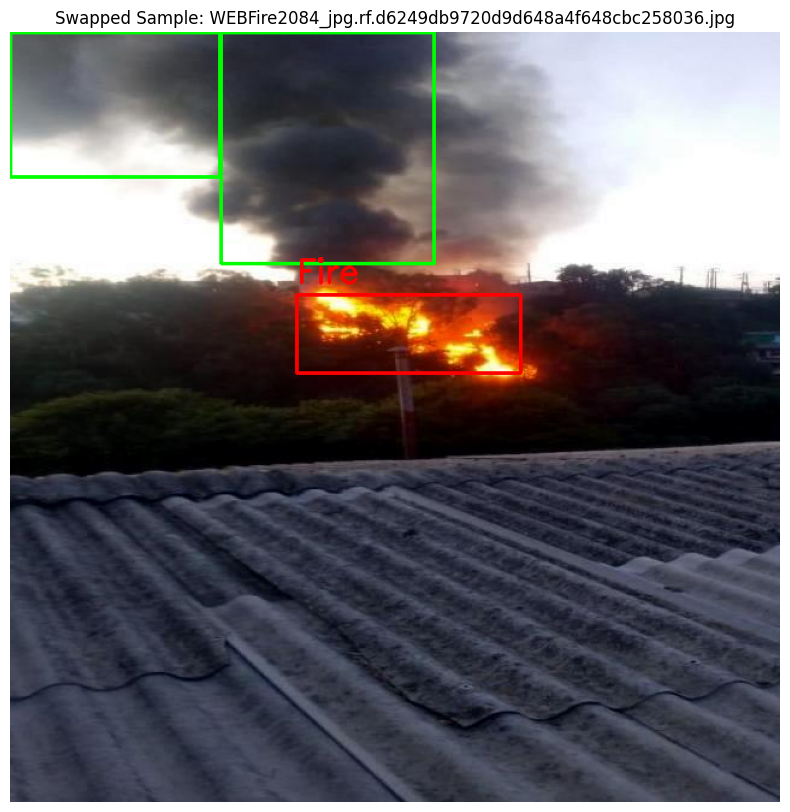

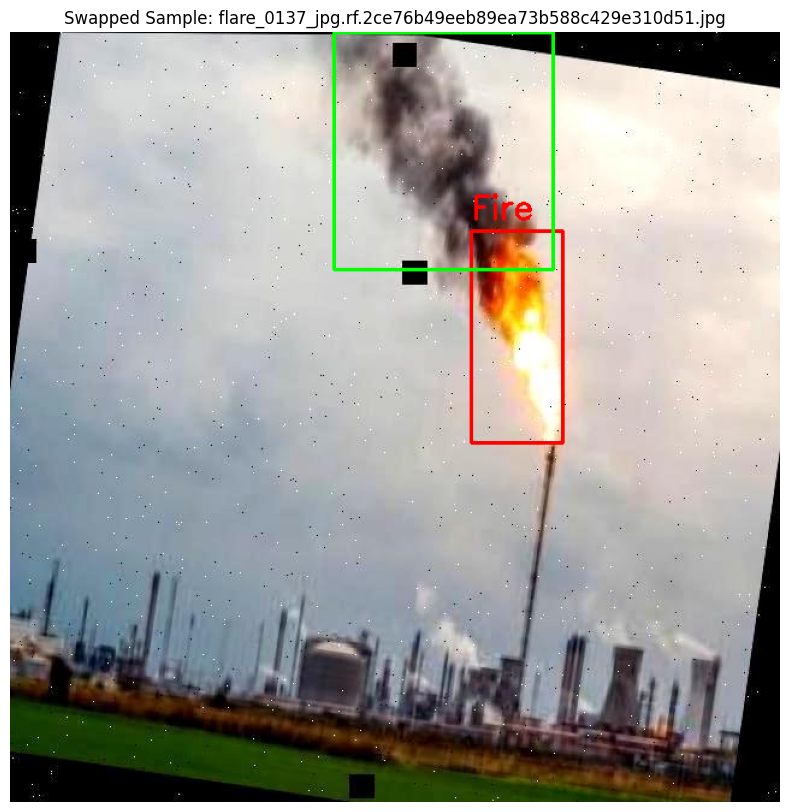

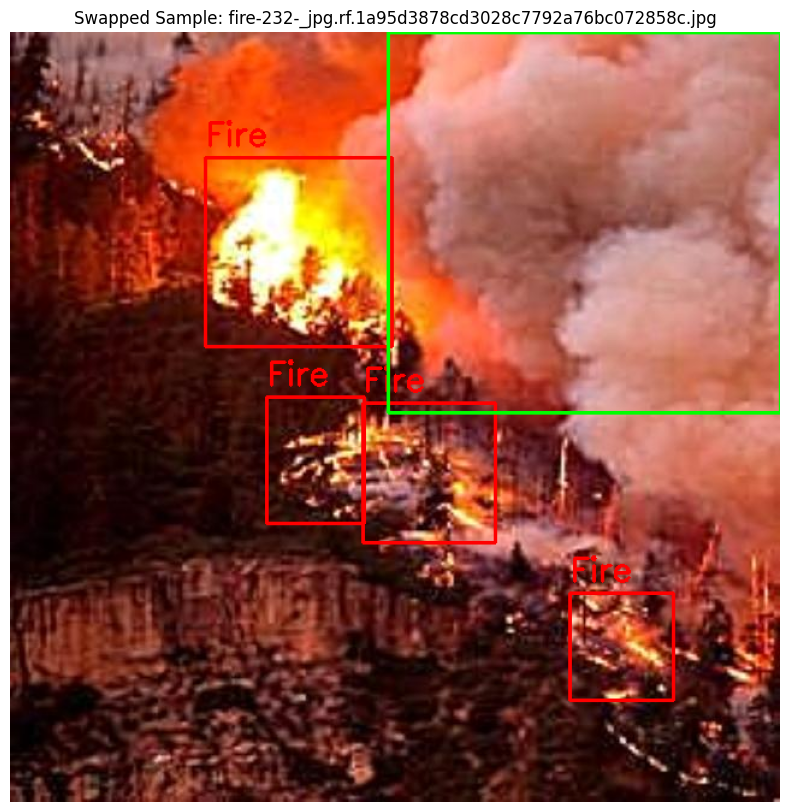

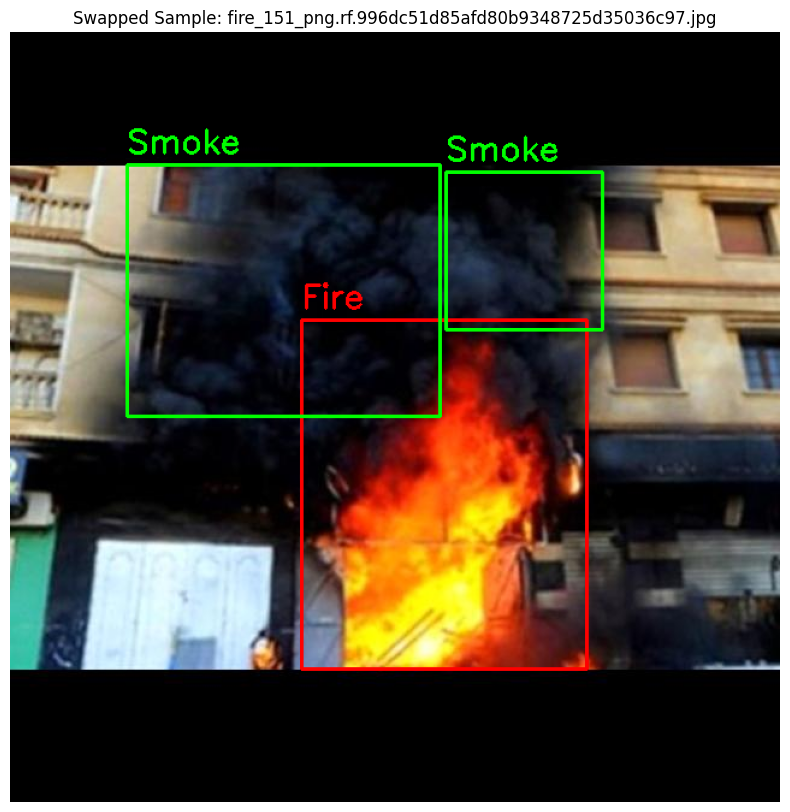

In [3]:
def visualize_sample(img_path, label_path, class_map=NEW_CLASS_NAMES):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h_img, w_img, _ = img.shape
    
    with open(label_path, 'r') as f:
        lines = f.readlines()
        
    for line in lines:
        parts = line.strip().split()
        if len(parts) >= 5:
            cls_id = int(parts[0])
            x_center, y_center, w, h = map(float, parts[1:5])
            
            # Convert YOLO format to corners
            x1 = int((x_center - w/2) * w_img)
            y1 = int((y_center - h/2) * h_img)
            x2 = int((x_center + w/2) * w_img)
            y2 = int((y_center + h/2) * h_img)
            
            # Visualization Colors
            # Class 1 (Fire) -> Red
            # Class 0 (Smoke) -> Green
            color = (255, 0, 0) if cls_id == 1 else (0, 255, 0) 
            
            cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
            label = class_map.get(cls_id, str(cls_id))
            cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
            
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Swapped Sample: {os.path.basename(img_path)}")
    plt.show()

import random
swapped_images = glob.glob(os.path.join(OUTPUT_ROOT, 'images', '*'))
if swapped_images:
    print("Visualizing random samples from Swapped Dataset:")
    for _ in range(30):
        img_path = random.choice(swapped_images)
        basename = os.path.splitext(os.path.basename(img_path))[0]
        label_path = os.path.join(OUTPUT_ROOT, 'labels', basename + '.txt')
        visualize_sample(img_path, label_path)
else:
    print("No images in swapped dataset.")